In [79]:
# 1. System and OS-level utilities
import os
import random
import warnings

# 2. Data handling and machine learning
import pandas as pd
from sklearn.model_selection import train_test_split

# 3. Image processing
from PIL import Image
import cv2

# 4. Visualization and plotting
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns

# 5. Suppress warnings
warnings.filterwarnings('ignore')

# 6. Networking and API communication
import requests

# 7. Jupyter-specific utilities
from IPython.display import display

# 8. Text matching and fuzzy string comparison
from fuzzywuzzy import process

# 9. pattern matching and text processing
import re

In [2]:
import numpy as np 
import pandas as pd 
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/yameel/256_yamel 0 t 255.yaml
/kaggle/input/uecfood100/UECFOOD100/category_ja_sjis.txt
/kaggle/input/uecfood100/UECFOOD100/multiple_food.txt
/kaggle/input/uecfood100/UECFOOD100/category_ja_utf8.txt
/kaggle/input/uecfood100/UECFOOD100/category.txt
/kaggle/input/uecfood100/UECFOOD100/README.txt
/kaggle/input/uecfood100/UECFOOD100/category_ja_euc.txt
/kaggle/input/uecfood100/UECFOOD100/7/623.jpg
/kaggle/input/uecfood100/UECFOOD100/7/654.jpg
/kaggle/input/uecfood100/UECFOOD100/7/14539.jpg
/kaggle/input/uecfood100/UECFOOD100/7/646.jpg
/kaggle/input/uecfood100/UECFOOD100/7/682.jpg
/kaggle/input/uecfood100/UECFOOD100/7/613.jpg
/kaggle/input/uecfood100/UECFOOD100/7/14586.jpg
/kaggle/input/uecfood100/UECFOOD100/7/626.jpg
/kaggle/input/uecfood100/UECFOOD100/7/9203.jpg
/kaggle/input/uecfood100/UECFOOD100/7/641.jpg
/kaggle/input/uecfood100/UECFOOD100/7/14840.jpg
/kaggle/input/uecfood100/UECFOOD100/7/622.jpg
/kaggle/input/uecfood100/UECFOOD100/7/15919.jpg
/kaggle/input/uecfood100/UECF

In [3]:
#get img_id & img_path & category name and id

# Define the root path of the UECFOOD100 dataset
data_path = "/kaggle/input/uecfood100/UECFOOD100"
data_list = []

# Load category names (id \t name)
category_file_path = os.path.join(data_path, "category.txt")
category_df = pd.read_csv(category_file_path, sep='\t', index_col='id')

if not category_df.empty:
    # loop through each folder
    for folder_id_str in os.listdir(data_path):
        try:
            folder_id = int(folder_id_str)
            folder_path = os.path.join(data_path, folder_id_str)
            if os.path.isdir(folder_path):
                # loop through imgs in each folder
                img_folder_path = folder_path
                for img_filename in os.listdir(img_folder_path):
                    if img_filename.endswith(".jpg"):

                        img_id = int(os.path.splitext(img_filename)[0])

                        img_path = os.path.join(img_folder_path, img_filename)#get img path

                        if folder_id in category_df.index:
                            category = category_df.loc[folder_id, 'name']
                            category_id = folder_id

                            data_list.append({
                                "img_id": img_id,
                                "img_path": img_path,
                                "category": category,
                                "category_id": category_id
                            })
        except ValueError:
            print(f"skip other folders: {folder_id_str}")

    data_df = pd.DataFrame(data_list)
    csv_output_path = "/kaggle/working/data_info.csv"
    data_df.to_csv(csv_output_path, index=False)

skip other folders: category_ja_sjis.txt
skip other folders: multiple_food.txt
skip other folders: category_ja_utf8.txt
skip other folders: category.txt
skip other folders: README.txt
skip other folders: category_ja_euc.txt


In [4]:
#get bounding box

# Load image info

csv_path = "/kaggle/working/data_info.csv"

data_df = pd.read_csv(csv_path)

# loop through each folder
for folder_id_str in os.listdir(data_path):
    try:
        folder_id = int(folder_id_str)
        folder_path = os.path.join(data_path, folder_id_str)
        if os.path.isdir(folder_path):
             # Read bounding box file into DataFrame
            bb_info_file_path = os.path.join(folder_path, "bb_info.txt")

            if os.path.exists(bb_info_file_path):
                try:
                          #create bb col
                          bb_info_df = pd.read_csv(bb_info_file_path, sep=' ', index_col=0, header=0, names=["x1", "y1", "x2", "y2"])

                          # loop through rows in bb_info_df
                          for img_id, bbox_info in bb_info_df.iterrows():
                            img_id = int(img_id)

                            pattern = f'/kaggle/input/uecfood100/UECFOOD100/{folder_id}/{img_id}.jpg'

                            matching_rows = data_df[data_df['img_path'] == pattern]

                            data_df.loc[matching_rows.index, ["x1", "y1", "x2", "y2"]] = [bbox_info["x1"], bbox_info["y1"], bbox_info["x2"], bbox_info["y2"]]

                except pd.errors.EmptyDataError:
                    print(f"No data found in {bb_info_file_path}")
    except ValueError:
        print(f"skip other folders: {folder_id_str}")

data_df.to_csv(csv_path, index=False)

skip other folders: category_ja_sjis.txt
skip other folders: multiple_food.txt
skip other folders: category_ja_utf8.txt
skip other folders: category.txt
skip other folders: README.txt
skip other folders: category_ja_euc.txt


In [5]:
data=pd.read_csv("/kaggle/working/data_info.csv")
data['category_id']=data['category_id']-1
data.to_csv('/kaggle/working/data_info.csv', index=False)
data.head()

,img_id,img_path,category,category_id,x1,y1,x2,y2
0,623,/kaggle/input/uecfood100/UECFOOD100/7/623.jpg,sushi,6,0.0,0.0,540.0,241.0
1,654,/kaggle/input/uecfood100/UECFOOD100/7/654.jpg,sushi,6,0.0,31.0,200.0,129.0
2,14539,/kaggle/input/uecfood100/UECFOOD100/7/14539.jpg,sushi,6,0.0,75.0,800.0,570.0
3,646,/kaggle/input/uecfood100/UECFOOD100/7/646.jpg,sushi,6,23.0,42.0,258.0,197.0
4,682,/kaggle/input/uecfood100/UECFOOD100/7/682.jpg,sushi,6,5.0,0.0,449.0,307.0


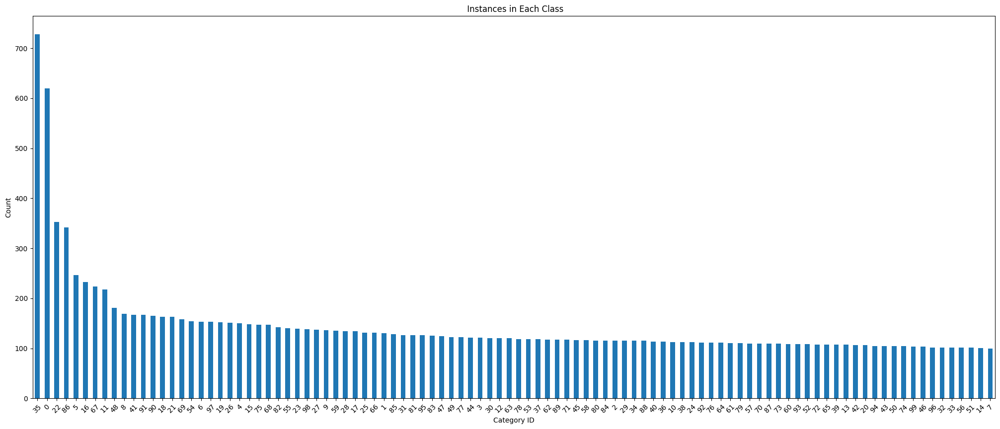

In [6]:
data=pd.read_csv('/kaggle/working/data_info.csv')
category_counts = data['category_id'].value_counts()

plt.figure(figsize=(25, 10))
category_counts.plot(kind='bar')
plt.title(' Instances in Each Class')
plt.xlabel('Category ID')
plt.ylabel('Count')
plt.xticks(rotation=45)

plt.show()

In [7]:
data=pd.read_csv("/kaggle/working/data_info.csv")

len(data) 

14361

In [8]:
data = pd.read_csv('/kaggle/working/data_info.csv')

categories_and_samples = {
    0 : 450,
    35: 580,
    22: 190,
    86: 150,
    5 : 80,
    16: 50,
    67: 50,
    11: 50
}

for category_id, sample_size in categories_and_samples.items():
    zero_category_rows = data[data['category_id'] == category_id]
    rows_to_delete = random.sample(list(zero_category_rows.index), sample_size)
    data = data.drop(rows_to_delete)

data.to_csv('/kaggle/working/balanced.csv', index=False)

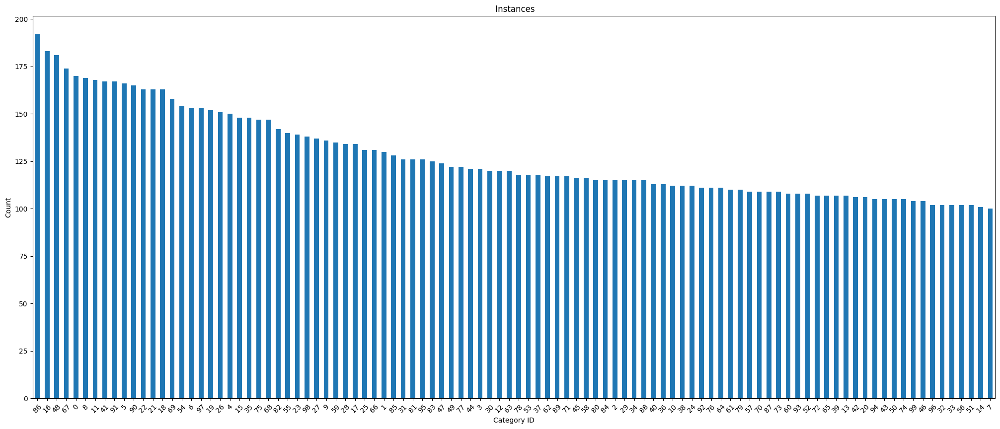

In [9]:
data=pd.read_csv('/kaggle/working/balanced.csv')
category_counts = data['category_id'].value_counts()

plt.figure(figsize=(25, 10))
category_counts.plot(kind='bar')
plt.title(' Instances')
plt.xlabel('Category ID')
plt.ylabel('Count')
plt.xticks(rotation=45)

plt.show()

In [10]:
n=pd.read_csv('/kaggle/working/balanced.csv')
len(n)

12761

In [11]:
df = pd.read_csv('/kaggle/working/balanced.csv')

merged_df = df.groupby('img_id', as_index=False).agg({
    'img_path': 'first',
    'category': lambda x: ','.join(x),
    'category_id': lambda x: ','.join(map(str, x)),
    'x1': lambda x: ','.join(map(str, x)),
    'y1': lambda x: ','.join(map(str, x)),
    'x2': lambda x: ','.join(map(str, x)),
    'y2': lambda x: ','.join(map(str, x))
})

merged_df.to_csv('/kaggle/working/multiple_data.csv', index=False)


In [12]:
df = pd.read_csv("/kaggle/working/multiple_data.csv")
df.head(10)

,img_id,img_path,category,category_id,x1,y1,x2,y2
0,1,/kaggle/input/uecfood100/UECFOOD100/42/1.jpg,"jiaozi,rice","41,0","363.0,0.0","91.0,143.0","800.0,370.0","560.0,486.0"
1,6,/kaggle/input/uecfood100/UECFOOD100/1/6.jpg,rice,0,0.0,38.0,369.0,310.0
2,9,/kaggle/input/uecfood100/UECFOOD100/24/9.jpg,beef noodle,23,278.0,76.0,798.0,509.0
3,12,/kaggle/input/uecfood100/UECFOOD100/1/12.jpg,rice,0,94.0,150.0,669.0,567.0
4,14,/kaggle/input/uecfood100/UECFOOD100/36/14.jpg,"miso soup,rice","35,0","264.0,0.0","314.0,337.0","516.0,240.0","557.0,600.0"
5,15,/kaggle/input/uecfood100/UECFOOD100/84/15.jpg,spaghetti meat sauce,83,578.0,221.0,798.0,370.0
6,16,/kaggle/input/uecfood100/UECFOOD100/99/16.jpg,mixed rice,98,0.0,4.0,436.0,354.0
7,19,/kaggle/input/uecfood100/UECFOOD100/70/19.jpg,"cold tofu,fermented soybeans","69,68","181.0,365.0","183.0,86.0","305.0,483.0","300.0,167.0"
8,20,/kaggle/input/uecfood100/UECFOOD100/1/20.jpg,rice,0,0.0,154.0,457.0,542.0
9,21,/kaggle/input/uecfood100/UECFOOD100/1/21.jpg,rice,0,8.0,5.0,456.0,285.0


In [13]:
data_df = pd.read_csv("/kaggle/working/multiple_data.csv")

train_df, test_df = train_test_split(data_df, test_size=0.1, random_state=42)
train_df, val_df = train_test_split(train_df, test_size=0.2, random_state=42)

train_csv_path = "/kaggle/working/train_data.csv"
val_csv_path = "/kaggle/working/val_data.csv"
test_csv_path = "/kaggle/working/test_data.csv"

train_df.to_csv(train_csv_path, index=False)
val_df.to_csv(val_csv_path, index=False)
test_df.to_csv(test_csv_path, index=False)

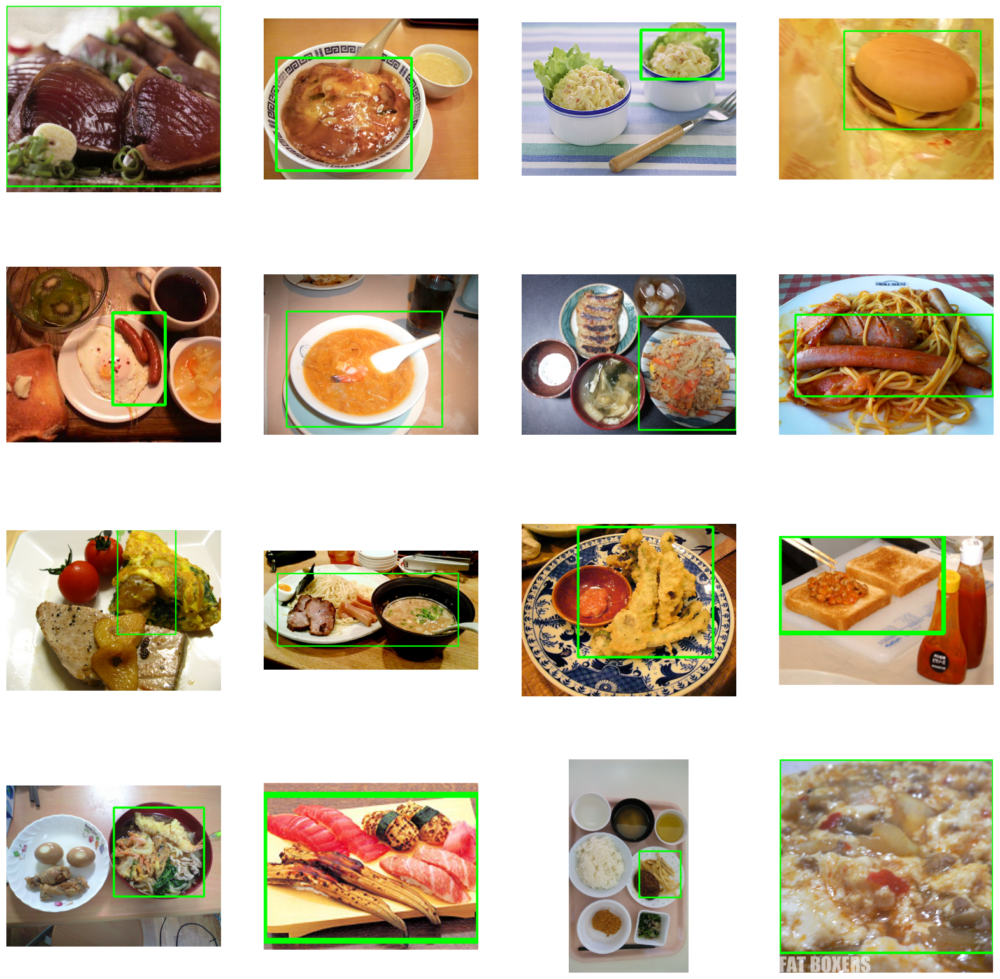

In [14]:
data_df = pd.read_csv("/kaggle/working/balanced.csv")


# Choose 16 random images from the dataframe
random_images = random.sample(range(len(data_df)), 16)

# Set up the plot with 4x4 grid
fig, axs = plt.subplots(4, 4, figsize=(20, 20))

for i, idx in enumerate(random_images):
    row = i // 4
    col = i % 4

    img_id = data_df.loc[idx, "img_id"]
    img_path = data_df.loc[idx, "img_path"]
    category_id = int(data_df.loc[idx, "category_id"])
    x1, y1, x2, y2 = int(data_df.loc[idx, "x1"]), int(data_df.loc[idx, "y1"]), int(data_df.loc[idx, "x2"]), int(data_df.loc[idx, "y2"])

    # Load the image
    img = cv2.imread(img_path)

    # Draw bounding box on the image
    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 3)

    # Display the image with bounding box
    axs[row, col].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.show()

In [15]:
train_images = "/kaggle/working/new_data/train/images"
train_labels = "/kaggle/working/new_data/train/labels"

val_images = "/kaggle/working/new_data/val/images"
val_labels = "/kaggle/working/new_data/val/labels"

test_images = "/kaggle/working/new_data/test/images"
test_labels = "/kaggle/working/new_data/test/labels"

# Train path

In [16]:
data_df = pd.read_csv("/kaggle/working/train_data.csv")

output_folder_path = "/kaggle/working/new_data/train"
os.makedirs(output_folder_path, exist_ok=True)

images_folder_path = os.path.join(output_folder_path, "images")
labels_folder_path = os.path.join(output_folder_path, "labels")
os.makedirs(images_folder_path, exist_ok=True)
os.makedirs(labels_folder_path, exist_ok=True)

def pascal_voc_to_yolo(x1, y1, x2, y2, image_w, image_h):
    x_center = (x1 + x2) / (2 * image_w)
    y_center = (y1 + y2) / (2 * image_h)
    width = (x2 - x1) / image_w
    height = (y2 - y1) / image_h
    return x_center, y_center, width, height

# Iterate over each row in the DataFrame
for _, row in data_df.iterrows():
    img_id = row["img_id"]
    img_path = row["img_path"]
    categories = row["category"].split(",")
    category_ids = [int(x) for x in str(row["category_id"]).split(",")]
    x1_values = [float(x) for x in str(row["x1"]).split(",")]
    y1_values = [float(x) for x in str(row["y1"]).split(",")]
    x2_values = [float(x) for x in str(row["x2"]).split(",")]
    y2_values = [float(x) for x in str(row["y2"]).split(",")]

    # Read and resize image
    img = cv2.imread(img_path)
    resized_img = cv2.resize(img, (640, 640))
    image_h, image_w, _ = resized_img.shape

    # Create a list to store records for each image
    image_records = []

    # Append records to the list
    for i in range(len(categories)):
        category_id = category_ids[i]
        x1, y1, x2, y2 = x1_values[i], y1_values[i], x2_values[i], y2_values[i]
        x_center, y_center, width, height = pascal_voc_to_yolo(x1, y1, x2, y2, img.shape[1], img.shape[0])
        record = f"{category_id} {x_center} {y_center} {width} {height}"
        image_records.append(record)

    # Write records to label text file
    label_filename = f"{img_id}.txt"
    label_destination_path = os.path.join(labels_folder_path, label_filename)
    with open(label_destination_path, "w") as label_file:
        for record in image_records:
            label_file.write(f"{record}\n")

    # Copy and resize images
    img_filename = f"{img_id}.jpg"
    img_destination_path = os.path.join(images_folder_path, img_filename)
    cv2.imwrite(img_destination_path, resized_img)


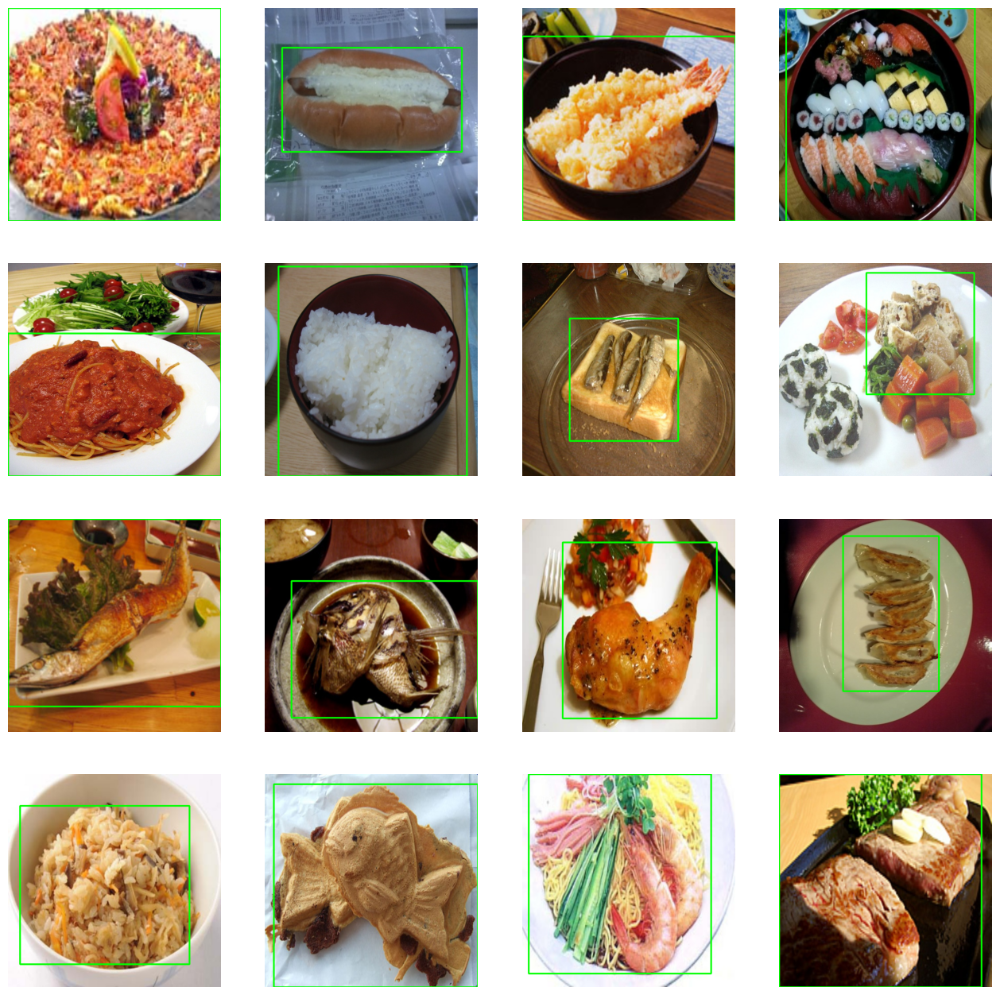

In [17]:
random_images = random.sample(os.listdir(train_images), 16)

fig, axs = plt.subplots(4, 4, figsize=(16, 16))

for i, image_file in enumerate(random_images):
    row = i // 4
    col = i % 4

    image_path = os.path.join(train_images, image_file)
    image = cv2.imread(image_path)

    # Load the labels for this image
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(train_labels, label_file)
    with open(label_path, "r") as f:
        labels = f.read().strip().split("\n")

    # Loop over the labels and plot the object detections
    for label in labels:
        if len(label.split()) != 5:
            continue

        class_id, x_center, y_center, width, height = map(float, label.split())

        x1 = int((x_center - width/2) * image.shape[1])
        y1 = int((y_center - height/2) * image.shape[0])
        x2 = int((x_center + width/2) * image.shape[1])
        y2 = int((y_center + height/2) * image.shape[0])
        
    cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 3)

    axs[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.show()

In [18]:
data_df = pd.read_csv("/kaggle/working/test_data.csv")

output_folder_path = "/kaggle/working/new_data/test"
os.makedirs(output_folder_path, exist_ok=True)

images_folder_path = os.path.join(output_folder_path, "images")
labels_folder_path = os.path.join(output_folder_path, "labels")
os.makedirs(images_folder_path, exist_ok=True)
os.makedirs(labels_folder_path, exist_ok=True)

def pascal_voc_to_yolo(x1, y1, x2, y2, image_w, image_h):
    x_center = (x1 + x2) / (2 * image_w)
    y_center = (y1 + y2) / (2 * image_h)
    width = (x2 - x1) / image_w
    height = (y2 - y1) / image_h
    return x_center, y_center, width, height

# Iterate over each row in the DataFrame
for _, row in data_df.iterrows():
    img_id = row["img_id"]
    img_path = row["img_path"]
    categories = row["category"].split(",")
    category_ids = [int(x) for x in str(row["category_id"]).split(",")]
    x1_values = [float(x) for x in str(row["x1"]).split(",")]
    y1_values = [float(x) for x in str(row["y1"]).split(",")]
    x2_values = [float(x) for x in str(row["x2"]).split(",")]
    y2_values = [float(x) for x in str(row["y2"]).split(",")]

    # Read and resize image
    img = cv2.imread(img_path)
    resized_img = cv2.resize(img, (640, 640))
    image_h, image_w, _ = resized_img.shape

    # Create a list to store records for each image
    image_records = []

    # Append records to the list
    for i in range(len(categories)):
        category_id = category_ids[i]
        x1, y1, x2, y2 = x1_values[i], y1_values[i], x2_values[i], y2_values[i]
        x_center, y_center, width, height = pascal_voc_to_yolo(x1, y1, x2, y2, img.shape[1], img.shape[0])
        record = f"{category_id} {x_center} {y_center} {width} {height}"
        image_records.append(record)

    # Write records to label text file
    label_filename = f"{img_id}.txt"
    label_destination_path = os.path.join(labels_folder_path, label_filename)
    with open(label_destination_path, "w") as label_file:
        for record in image_records:
            label_file.write(f"{record}\n")

    # Copy and resize images
    img_filename = f"{img_id}.jpg"
    img_destination_path = os.path.join(images_folder_path, img_filename)
    cv2.imwrite(img_destination_path, resized_img)

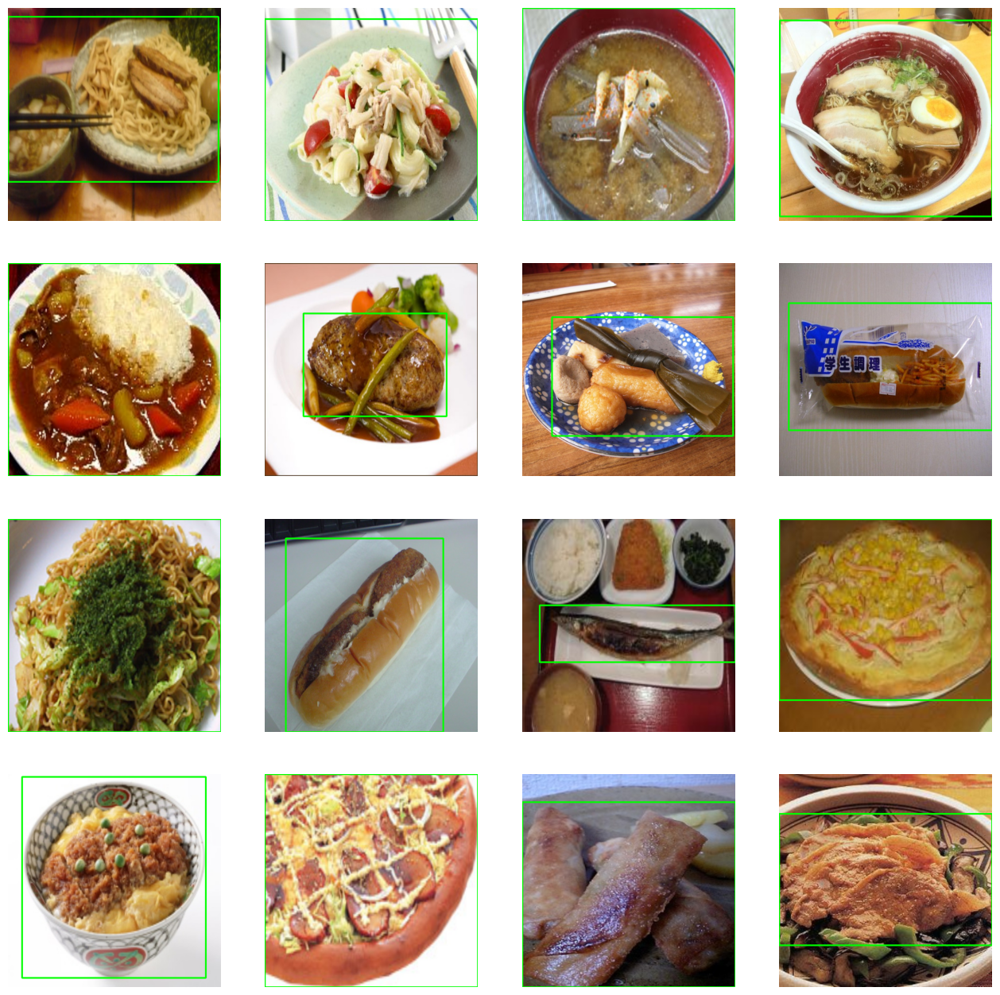

In [19]:
random.seed(42)

random_images = random.sample(os.listdir(test_images), 16)

fig, axs = plt.subplots(4, 4, figsize=(16, 16))

for i, image_file in enumerate(random_images):
    row = i // 4
    col = i % 4

    # Load the image
    image_path = os.path.join(test_images, image_file)
    image = cv2.imread(image_path)

    # Load the labels for this image
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(test_labels, label_file)
    with open(label_path, "r") as f:
        labels = f.read().strip().split("\n")

    # Loop over the labels and plot the object detections
    for label in labels:
        if len(label.split()) != 5:
            continue

        class_id, x_center, y_center, width, height = map(float, label.split())

        x1 = int((x_center - width/2) * image.shape[1])
        y1 = int((y_center - height/2) * image.shape[0])
        x2 = int((x_center + width/2) * image.shape[1])
        y2 = int((y_center + height/2) * image.shape[0])

    cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 3)

    # Show the image with bounding boxes
    axs[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.show()

In [20]:
data_df = pd.read_csv("/kaggle/working/val_data.csv")

output_folder_path = "/kaggle/working/new_data/val"
os.makedirs(output_folder_path, exist_ok=True)

images_folder_path = os.path.join(output_folder_path, "images")
labels_folder_path = os.path.join(output_folder_path, "labels")
os.makedirs(images_folder_path, exist_ok=True)
os.makedirs(labels_folder_path, exist_ok=True)

def pascal_voc_to_yolo(x1, y1, x2, y2, image_w, image_h):
    x_center = (x1 + x2) / (2 * image_w)
    y_center = (y1 + y2) / (2 * image_h)
    width = (x2 - x1) / image_w
    height = (y2 - y1) / image_h
    return x_center, y_center, width, height

# Iterate over each row in the DataFrame
for _, row in data_df.iterrows():
    img_id = row["img_id"]
    img_path = row["img_path"]
    categories = row["category"].split(",")
    category_ids = [int(x) for x in str(row["category_id"]).split(",")]
    x1_values = [float(x) for x in str(row["x1"]).split(",")]
    y1_values = [float(x) for x in str(row["y1"]).split(",")]
    x2_values = [float(x) for x in str(row["x2"]).split(",")]
    y2_values = [float(x) for x in str(row["y2"]).split(",")]

    # Read and resize image
    img = cv2.imread(img_path)
    resized_img = cv2.resize(img, (640, 640))
    image_h, image_w, _ = resized_img.shape

    # Create a list to store records for each image
    image_records = []

    # Append records to the list
    for i in range(len(categories)):
        category_id = category_ids[i]
        x1, y1, x2, y2 = x1_values[i], y1_values[i], x2_values[i], y2_values[i]
        x_center, y_center, width, height = pascal_voc_to_yolo(x1, y1, x2, y2, img.shape[1], img.shape[0])
        record = f"{category_id} {x_center} {y_center} {width} {height}"
        image_records.append(record)

    # Write records to label text file
    label_filename = f"{img_id}.txt"
    label_destination_path = os.path.join(labels_folder_path, label_filename)
    with open(label_destination_path, "w") as label_file:
        for record in image_records:
            label_file.write(f"{record}\n")

    # Copy and resize images
    img_filename = f"{img_id}.jpg"
    img_destination_path = os.path.join(images_folder_path, img_filename)
    cv2.imwrite(img_destination_path, resized_img)

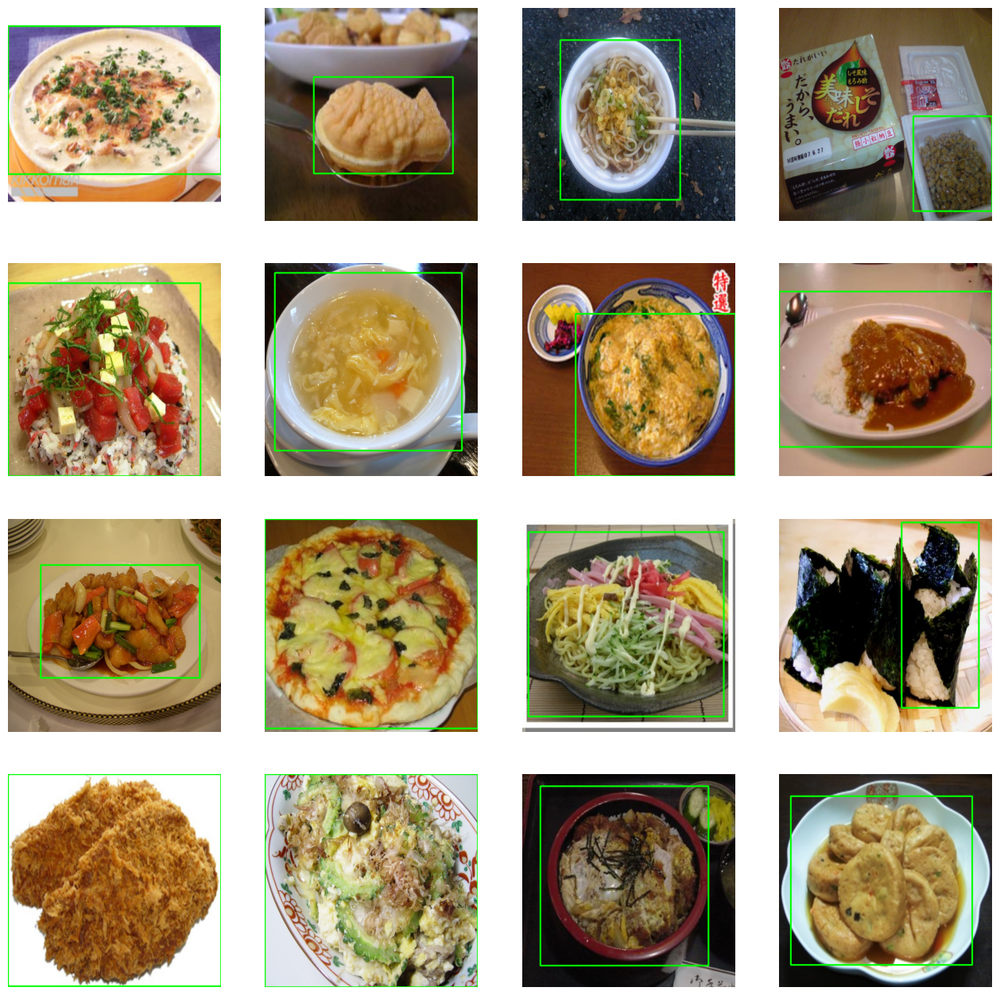

In [21]:
random_images = random.sample(os.listdir(val_images), 16)

fig, axs = plt.subplots(4, 4, figsize=(16, 16))

for i, image_file in enumerate(random_images):
    row = i // 4
    col = i % 4

    # Load the image
    image_path = os.path.join(val_images, image_file)
    image = cv2.imread(image_path)

    # Load the labels for this image
    label_file = os.path.splitext(image_file)[0] + ".txt"
    label_path = os.path.join(val_labels, label_file)
    with open(label_path, "r") as f:
        labels = f.read().strip().split("\n")

    # Loop over the labels and plot the object detections
    for label in labels:
        if len(label.split()) != 5:
            continue

        class_id, x_center, y_center, width, height = map(float, label.split())

        x1 = int((x_center - width/2) * image.shape[1])
        y1 = int((y_center - height/2) * image.shape[0])
        x2 = int((x_center + width/2) * image.shape[1])
        y2 = int((y_center + height/2) * image.shape[0])

        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 3)

    # Show the image with bounding boxes
    axs[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[row, col].axis('off')

plt.show()

In [22]:
 import os
 import shutil
 working_directory = '/kaggle/working/new_data/test'
 shutil.make_archive('/kaggle/working/test', 'zip', working_directory)

'/kaggle/working/test.zip'

In [23]:
%pip install ultralytics
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 26.9 MB/s eta 0:00:0000:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.3 MB/s eta 0:00:000:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 27.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.9 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 5.1 MB/s eta 0:00:000:00:0100:01
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existing

In [24]:
from ultralytics import YOLO 

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [25]:
train_data = os.listdir(train_images)

train_image_file_paths = [os.path.join(train_images,i) for i in train_data if '.jpg' in i]
len(train_image_file_paths)

8638

In [26]:
val_data = os.listdir(val_images)

val_image_file_paths = [os.path.join(val_images,i) for i in val_data if '.jpg' in i]
len(val_image_file_paths)

2160

In [27]:
test_data = os.listdir(test_images)

test_image_file_paths = [os.path.join(test_images,i) for i in test_data if '.jpg' in i]
len(test_image_file_paths)

1200

In [28]:
# model = YOLO('yolov8m.pt')

# model.train(data = '/kaggle/input/yamel2/data (1).yaml',
#             epochs = 50,
#             imgsz = 640,
#             seed = 42,
#             patience=20,
#             save=True,
#             batch = 30,
#             workers = 4)

In [29]:
!pip install kagglehub


In [30]:
import kagglehub


In [31]:
from ultralytics import YOLO

model_path = '/kaggle/input/best/pytorch/default/1/best (2).pt'  
model = YOLO(model_path)

metrics = model.val(conf=0.25, split='test')

Ultralytics 8.3.124 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 92 layers, 29,218,832 parameters, 0 gradients, 104.0 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 22.5MB/s]

val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2020.5±524.4 MB/s, size: 103.2 KB)



val: Scanning /kaggle/working/new_data/test/labels... 1200 images, 0 backgrounds, 8 corrupt: 100%|██████████| 1200/1200 [00:00<00:00, 1522.75it/s]

val: /kaggle/working/new_data/test/images/11435.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0056      1.5444]
val: /kaggle/working/new_data/test/images/2338.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0583]
val: /kaggle/working/new_data/test/images/2891.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.2012]
val: /kaggle/working/new_data/test/images/297.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [       1.07]
val: /kaggle/working/new_data/test/images/3199.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.3333]
val: /kaggle/working/new_data/test/images/8101.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0921]
val: /kaggle/working/new_data/test/images/8780.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.1392]
val: /ka


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 75/75 [00:21<00:00,  3.54it/s]


                   all       1192       1280      0.907      0.886      0.926      0.845
                   247         18         18      0.419      0.441      0.429      0.327
                     6         12         12          1          1      0.995      0.964
                   134         11         11      0.846          1      0.903      0.865
                    46          7          7      0.875          1      0.995      0.976
                   182         16         16      0.941          1      0.995      0.923
                    16         23         23      0.875      0.913      0.937      0.848
                    80         13         13      0.958          1      0.995      0.847
                    18          8          8      0.922          1      0.995      0.874
                   198         14         14      0.954      0.714      0.844      0.798
                   120         14         14      0.958          1      0.995      0.941
                   19

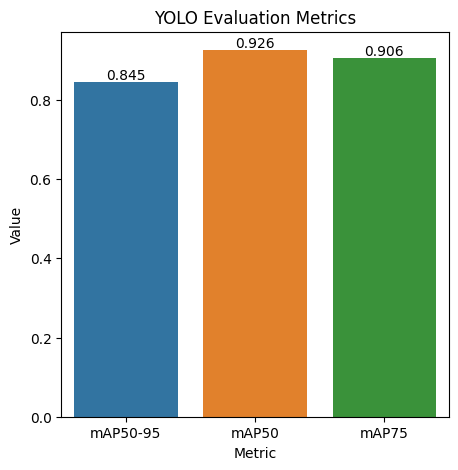

In [32]:
%matplotlib inline
ax = sns.barplot(x=['mAP50-95', 'mAP50', 'mAP75'], y=[metrics.box.map, metrics.box.map50, metrics.box.map75])
ax.set_title('YOLO Evaluation Metrics')
ax.set_xlabel('Metric')
ax.set_ylabel('Value')
fig = plt.gcf()
fig.set_size_inches(5, 5)
for p in ax.patches:
    ax.annotate('{:.3f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', va='bottom')
plt.show()


0: 640x640 1 16, 19.0ms
Speed: 1.6ms preprocess, 19.0ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 59, 19.0ms
Speed: 1.7ms preprocess, 19.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 204, 18.9ms
Speed: 1.7ms preprocess, 18.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 226, 18.9ms
Speed: 2.1ms preprocess, 18.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 146, 18.7ms
Speed: 2.4ms preprocess, 18.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 243, 18.7ms
Speed: 2.3ms preprocess, 18.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 147, 18.7ms
Speed: 2.5ms preprocess, 18.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 88, 18.4ms
Speed: 2.5ms preprocess, 18.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 44, 1

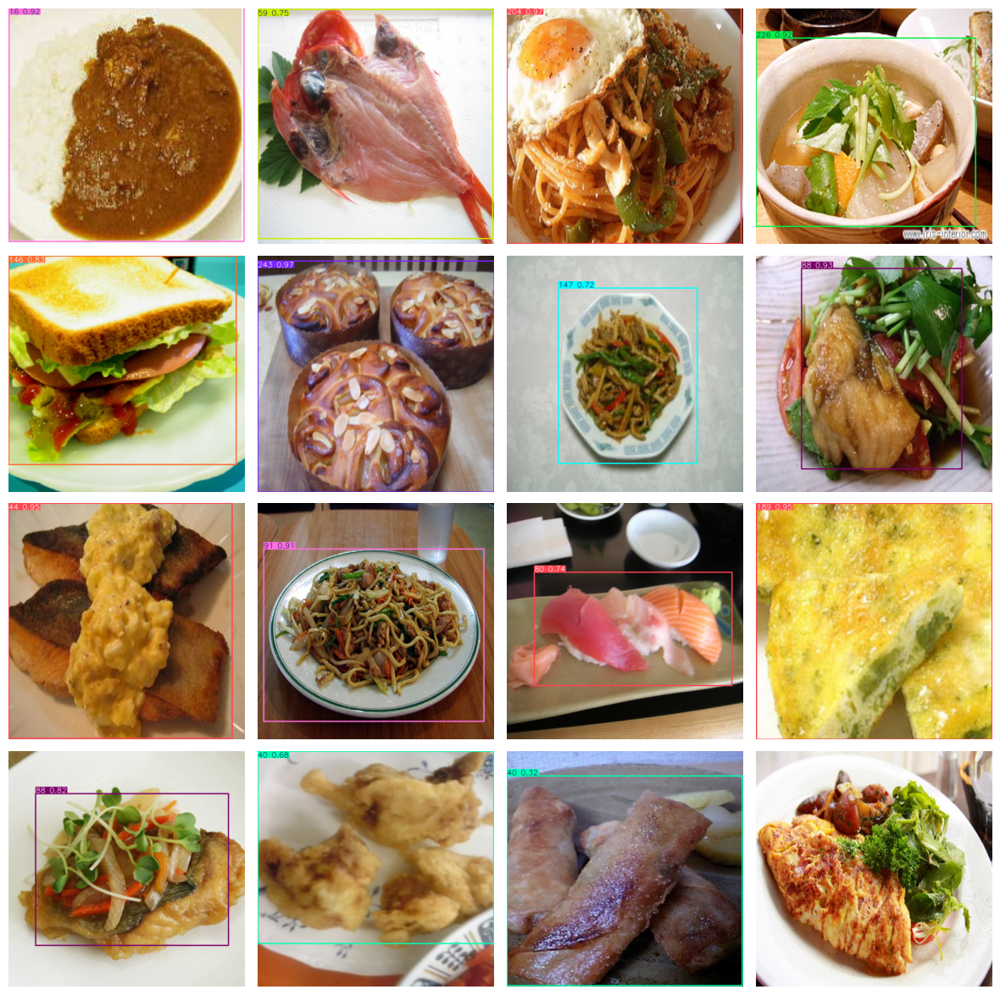

In [33]:
def img_detect(img_path):

    img = cv2.imread(img_path)
    detect_result = model(img)

    detect_img = detect_result[0].plot()
    detect_img = cv2.cvtColor(detect_img, cv2.COLOR_BGR2RGB)
    return detect_img


custom_image_dir = "/kaggle/working/new_data/test/images"

image_files = os.listdir(custom_image_dir)

selected_images = random.sample(image_files, 16)

fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(15, 15))

for i, img_file in enumerate(selected_images):

    row_idx = i // 4
    col_idx = i % 4
    img_path = os.path.join(custom_image_dir, img_file)
    detect_img = img_detect(img_path)
    axes[row_idx, col_idx].imshow(detect_img)
    axes[row_idx, col_idx].axis('off')

plt.subplots_adjust(wspace=0.05, hspace=0.05)

In [34]:
import os

detect_root = "/kaggle/working/runs/detect"
if os.path.exists(detect_root):
    folders = [os.path.join(detect_root, d) for d in os.listdir(detect_root)]
    folders = [f for f in folders if os.path.isdir(f)]
    folders.sort(key=os.path.getmtime, reverse=True)
    if folders:
        latest_folder = folders[0]
        print("Most recent output folder:", latest_folder)
        print("Contents:", os.listdir(latest_folder))
    else:
        print("No subfolders found in 'runs/detect'")
else:
    print("No 'runs/detect' directory found.")


Most recent output folder: /kaggle/working/runs/detect/val
Contents: ['val_batch1_pred.jpg', 'val_batch1_labels.jpg', 'PR_curve.png', 'P_curve.png', 'confusion_matrix_normalized.png', 'val_batch2_pred.jpg', 'val_batch2_labels.jpg', 'confusion_matrix.png', 'R_curve.png', 'val_batch0_labels.jpg', 'F1_curve.png', 'val_batch0_pred.jpg']


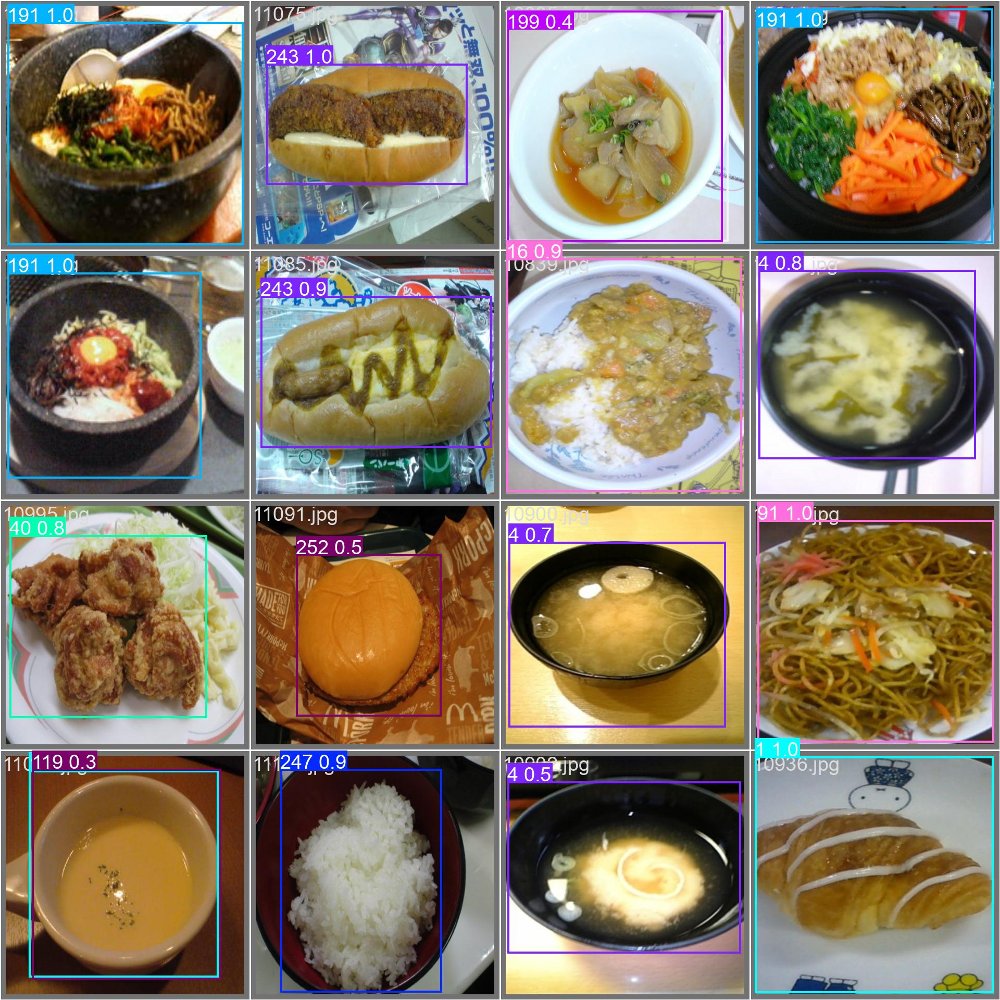

In [35]:
from PIL import Image
from IPython.display import display

img_path = "/kaggle/working/runs/detect/val/val_batch2_pred.jpg"
img = Image.open(img_path)
display(img)


In [38]:
!yolo task=detect mode=predict model="/kaggle/input/best/pytorch/default/1/best (2).pt" conf=0.5 source="/kaggle/working/new_data/test/images/10936.jpg"


Ultralytics 8.3.124 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 92 layers, 29,218,832 parameters, 0 gradients, 104.0 GFLOPs

image 1/1 /kaggle/working/new_data/test/images/10936.jpg: 640x640 1 1, 19.2ms
Speed: 5.6ms preprocess, 19.2ms inference, 164.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


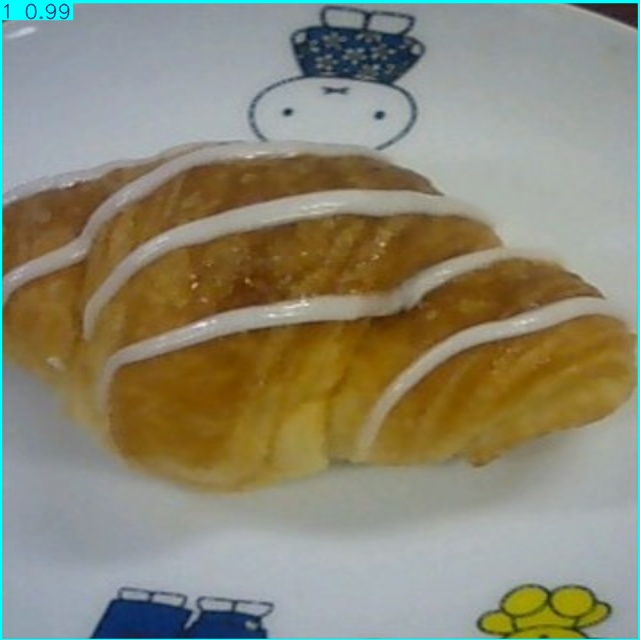

In [39]:
from PIL import Image
from IPython.display import display

img_path = "/kaggle/working/runs/detect/predict/10936.jpg"

img = Image.open(img_path)
display(img)


> # **Nutritional Database Integration**  

In [40]:
# Inspect the column names to locate food label information

csv_path = "/kaggle/working/data_info.csv"
df = pd.read_csv(csv_path)

print(df.columns)

Index(['img_id', 'img_path', 'category', 'category_id', 'x1', 'y1', 'x2',
       'y2'],
      dtype='object')


In [51]:
# Export unique categories to file

categories = df['category'].drop_duplicates().reset_index(drop=True)

categories.to_csv('/kaggle/working/category.txt', index_label='id', header=['name'], sep='\t')

In [52]:
!pip install requests

In [108]:
# Configure USDA API key for authentication
USDA_API_KEY = 'O0b5qg2AggIkhh0Hbqj3QsUbPIw2DSoCGL1o3lkc'

In [109]:
def search_food_usda(food_name):
    
    url = 'https://api.nal.usda.gov/fdc/v1/foods/search'
    params = {
        'api_key': USDA_API_KEY,
        'query': food_name,
        'pageSize': 1  
    }
    
    response = requests.get(url, params=params)
    
    if response.status_code == 200:
        data = response.json()
        if 'foods' in data and len(data['foods']) > 0:
            food_data = data['foods'][0]
            nutrients = food_data.get('foodNutrients', [])
            
            nutrition_info = {}
            for nutrient in nutrients:
                name = nutrient.get('nutrientName')
                value = nutrient.get('value')
                unit = nutrient.get('unitName')
                nutrition_info[name] = f"{value} {unit}"
            
            return {
                'description': food_data.get('description'),
                'nutrition': nutrition_info
            }
        else:
            return {'error': 'No food found matching your search.'}
    else:
        return {'error': f"Failed API request with status code {response.status_code}"}

def load_food_categories(file_path):
    
    df = pd.read_csv(file_path, delimiter='\t')  
    food_names = df['name'].tolist()
    return food_names

def retrieve_nutrition_for_all_categories(food_list):
    
    all_results = {}
    for food in food_list:
        print(f"Searching for: {food}")
        result = search_food_usda(food)
        all_results[food] = result
    return all_results

# Example Usage
if __name__ == "__main__":
    
    food_categories_file = '/kaggle/working/category.txt'  
    food_names_list = load_food_categories(food_categories_file)

    all_nutrition_data = retrieve_nutrition_for_all_categories(food_names_list)

    for food, data in all_nutrition_data.items():
        print(f"\nFood: {food}")
        print(f"Nutrition Info: {data}")


Searching for: sushi
Searching for: salmon meuniere 
Searching for: hamburger
Searching for: steamed meat dumpling
Searching for: sandwiches
Searching for: soba noodle
Searching for: eels on rice
Searching for: vegetable tempura
Searching for: beef bowl
Searching for: sukiyaki
Searching for: ramen noodle
Searching for: green salad
Searching for: tempura bowl
Searching for: pork cutlet on rice
Searching for: beef steak
Searching for: miso soup
Searching for: udon noodle
Searching for: fried fish
Searching for: hambarg steak
Searching for: spaghetti
Searching for: spicy chili-flavored tofu
Searching for: ganmodoki
Searching for: Japanese tofu and vegetable chowder
Searching for: oden
Searching for: croquette
Searching for: french fries
Searching for: tensin noodle
Searching for: jiaozi
Searching for: lightly roasted fish
Searching for: boiled chicken and vegetables
Searching for: chicken rice
Searching for: sausage
Searching for: toast
Searching for: rice ball
Searching for: fried chicke

In [110]:
# Find missing foods

missing_foods = [food for food, data in all_nutrition_data.items() if 'error' in data]

print("\nFoods not found in USDA database:")

for food in missing_foods:
    print(food)


Foods not found in USDA database:
ganmodoki
nanbanzuke
takoyaki


In [111]:
# Substitute unknown foods

manual_food_mapping = {
    'ganmodoki': 'tofu',
    'nanbanzuke': 'fried fish',
    'takoyaki': 'octopus'
}

def adjust_food_name(food_name):
    """ Substitute unavailable food name """
    return manual_food_mapping.get(food_name.lower(), food_name)

def retrieve_nutrition_for_all_categories(food_list):
    
    all_results = {}
    for food in food_list:
        adjusted_food = adjust_food_name(food)
        print(f"Searching for: {adjusted_food} (original: {food})")
        result = search_food_usda(adjusted_food)
        all_results[food] = result  
    return all_results


In [112]:
def retrieve_nutrition_with_manual_mapping(food_list, manual_mapping):
    all_results = {}
    for original_food in food_list:
        search_name = manual_mapping.get(original_food.lower(), original_food)
        print(f"Searching for '{search_name}' (original: '{original_food}')")
        result = search_food_usda(search_name)
        all_results[original_food] = result
    return all_results

# Usage
if __name__ == "__main__":
    food_categories_file = '/kaggle/working/category.txt'  
    food_names_list = load_food_categories(food_categories_file)

    manual_food_mapping = {
        'ganmodoki': 'tofu',
        'nanbanzuke': 'fried fish',
        'takoyaki': 'octopus'
    }

    all_nutrition_data = retrieve_nutrition_with_manual_mapping(food_names_list, manual_food_mapping)

    for food, data in all_nutrition_data.items():
        print(f"\nFood: {food}")
        print(f"Nutrition Info: {data}")


Searching for 'sushi' (original: 'sushi')
Searching for 'salmon meuniere ' (original: 'salmon meuniere ')
Searching for 'hamburger' (original: 'hamburger')
Searching for 'steamed meat dumpling' (original: 'steamed meat dumpling')
Searching for 'sandwiches' (original: 'sandwiches')
Searching for 'soba noodle' (original: 'soba noodle')
Searching for 'eels on rice' (original: 'eels on rice')
Searching for 'vegetable tempura' (original: 'vegetable tempura')
Searching for 'beef bowl' (original: 'beef bowl')
Searching for 'sukiyaki' (original: 'sukiyaki')
Searching for 'ramen noodle' (original: 'ramen noodle')
Searching for 'green salad' (original: 'green salad')
Searching for 'tempura bowl' (original: 'tempura bowl')
Searching for 'pork cutlet on rice' (original: 'pork cutlet on rice')
Searching for 'beef steak' (original: 'beef steak')
Searching for 'miso soup' (original: 'miso soup')
Searching for 'udon noodle' (original: 'udon noodle')
Searching for 'fried fish' (original: 'fried fish')


In [113]:
# Detect and label food items

detect_result = model(img)

result = detect_result[0]

class_indices = result.boxes.cls

names = model.names

predicted_labels = [names[int(cls_idx)] for cls_idx in class_indices]

print("Predicted food labels:", predicted_labels)


0: 640x640 1 1, 19.6ms
Speed: 2.6ms preprocess, 19.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
Predicted food labels: ['1']


In [114]:
category_file = '/kaggle/input/uecfood100/UECFOOD100/category.txt'

class_id_to_label = {}

with open(category_file, 'r') as f:
    next(f)  
    for line in f:
        parts = line.strip().split(None, 1)  
        class_id = int(parts[0]) - 1
        food_name = parts[1]
        class_id_to_label[class_id] = food_name

print(class_id_to_label)

{0: 'rice', 1: 'eels on rice', 2: 'pilaf', 3: "chicken-'n'-egg on rice", 4: 'pork cutlet on rice', 5: 'beef curry', 6: 'sushi', 7: 'chicken rice', 8: 'fried rice', 9: 'tempura bowl', 10: 'bibimbap', 11: 'toast', 12: 'croissant', 13: 'roll bread', 14: 'raisin bread', 15: 'chip butty', 16: 'hamburger', 17: 'pizza', 18: 'sandwiches', 19: 'udon noodle', 20: 'tempura udon', 21: 'soba noodle', 22: 'ramen noodle', 23: 'beef noodle', 24: 'tensin noodle', 25: 'fried noodle', 26: 'spaghetti', 27: 'Japanese-style pancake', 28: 'takoyaki', 29: 'gratin', 30: 'sauteed vegetables', 31: 'croquette', 32: 'grilled eggplant', 33: 'sauteed spinach', 34: 'vegetable tempura', 35: 'miso soup', 36: 'potage', 37: 'sausage', 38: 'oden', 39: 'omelet', 40: 'ganmodoki', 41: 'jiaozi', 42: 'stew', 43: 'teriyaki grilled fish', 44: 'fried fish', 45: 'grilled salmon', 46: 'salmon meuniere', 47: 'sashimi', 48: 'grilled pacific saury', 49: 'sukiyaki', 50: 'sweet and sour pork', 51: 'lightly roasted fish', 52: 'steamed eg

In [115]:
detect_result = model(img)

result = detect_result[0]

class_indices = result.boxes.cls

predicted_labels = [class_id_to_label[int(cls_idx)] for cls_idx in class_indices]

print("Predicted food labels:", predicted_labels)


0: 640x640 1 1, 19.0ms
Speed: 1.3ms preprocess, 19.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Predicted food labels: ['croissant']


In [116]:
predicted_labels = []
for result in detect_result:
    for box in result.boxes:
        predicted_labels.append(class_id_to_label[int(box.cls)])

print("Predicted YOLO labels:", predicted_labels)


def fuzzy_match_food(yolo_label, database_labels):
    best_match = process.extractOne(yolo_label, database_labels)
    if best_match and best_match[1] >= 80:  
        return best_match[0]
    return None  


database_food_names = list(class_id_to_label.values())


# Match YOLO labels to database names
mapped_food_labels = []
unmatched_labels = []  

for label in predicted_labels:
    matched_food = fuzzy_match_food(label, database_food_names)
    if matched_food:
        mapped_food_labels.append(matched_food)
    else:
        unmatched_labels.append(label)  


if unmatched_labels:
    print(f"Some YOLO labels couldn't be matched to the database: {unmatched_labels}")
else:
    print("All YOLO labels were successfully mapped to database food items.")
  

print("Mapped food labels to database:", mapped_food_labels)


Predicted YOLO labels: ['croissant']
All YOLO labels were successfully mapped to database food items.
Mapped food labels to database: ['croissant']


In [117]:
def get_nutrition_info_usda(food_name):

    """ Query USDA API for food's nutritional information """

    try:
        search_url = 'https://api.nal.usda.gov/fdc/v1/foods/search'
        params = {
            'query': food_name,
            'pageSize': 1,
            'api_key': API_KEY
        }

        search_response = requests.get(search_url, params=params)
        search_response.raise_for_status()
        search_data = search_response.json()

        foods = search_data.get('foods')
        if not foods:
            print(f"No USDA results found for '{food_name}'.")
            return None

        fdc_id = foods[0]['fdcId']
        print(f"\n Found USDA match: {foods[0]['description']} (FDC ID: {fdc_id})")

        return fdc_id

    except requests.RequestException as e:
        print(f"API request error: {e}")
        return None

In [118]:
def get_detailed_nutrition_info(fdc_id):
    
    """ Get nutrition information using FDC ID """
    
    try:
        details_url = f'https://api.nal.usda.gov/fdc/v1/food/{fdc_id}'
        detail_response = requests.get(details_url, params={'api_key': API_KEY})
        detail_response.raise_for_status()
        detail_data = detail_response.json()

        print("\nRaw USDA API response:")
        print(detail_data)

        return detail_data

    except requests.RequestException as e:
        print(f"API request error: {e}")
        return None

In [119]:
def extract_nutrition_info(detail_data):
    
    """ Extract nutrition data from USDA response """
    
    usda_to_key = {
        'Energy': 'calories',
        'Protein': 'proteins',
        'Total lipid (fat)': 'fat',
        'Carbohydrate, by difference': 'carbohydrates',
        'Total Sugars': 'sugars',
        'Fiber, total dietary': 'fiber',
        'Fatty acids, total saturated': 'saturated_fat',
        'Cholesterol': 'cholesterol',
        'Sodium, Na': 'sodium',
        'Potassium, K': 'potassium'
    }

    nutrition_info = {
        'food_name': detail_data.get('description', ''),
        'calories': None,
        'carbohydrates': None,
        'sugars': None,
        'fiber': None,
        'proteins': None,
        'fat': None,
        'saturated_fat': None,
        'sodium': None,
        'potassium': None,
        'cholesterol': None
    }

    # 1. Process the foodNutrients field
    for nutrient in detail_data.get('foodNutrients', []):
        name = nutrient['nutrient']['name']
        value = nutrient['amount']
        unit = nutrient['nutrient']['unitName']

        if name in usda_to_key and value is not None:
            key = usda_to_key[name]
            nutrition_info[key] = f"{value} {unit}"

    # 2. Process the labelNutrients field
    for key in nutrition_info.keys():
        if nutrition_info[key] is None:  
            label_value = detail_data.get('labelNutrients', {}).get(key, {}).get('value')
            if label_value is not None:
                nutrition_info[key] = f"{label_value} g"  

    return nutrition_info

In [120]:
def print_missing_data_warnings(nutrition_info):
    
    """Print warnings for missing data in nutrition information """
    
    for key, value in nutrition_info.items():
        if value is None:
            print(f" Missing data for {key}")


In [121]:
# Example usage

mapped_food_labels = [matched_food]  

for label in mapped_food_labels:
    fdc_id = get_nutrition_info_usda(label)
    if fdc_id:
        detail_data = get_detailed_nutrition_info(fdc_id)
        if detail_data:
            nutrition_info = extract_nutrition_info(detail_data)
            print(f"\n Nutrition info for '{label}':")
            for k, v in nutrition_info.items():
                print(f"{k}: {v}")
            print_missing_data_warnings(nutrition_info)
        else:
            print(f" Could not retrieve detailed data for {label}")
    else:
        print(f" Could not retrieve data for {label}")


 Found USDA match: Croissant (FDC ID: 2707678)

Raw USDA API response:
{'foodClass': 'Survey', 'description': 'Croissant', 'foodNutrients': [{'type': 'FoodNutrient', 'id': 34285269, 'nutrient': {'id': 1003, 'number': '203', 'name': 'Protein', 'rank': 600, 'unitName': 'g'}, 'amount': 8.2}, {'type': 'FoodNutrient', 'id': 34285270, 'nutrient': {'id': 1004, 'number': '204', 'name': 'Total lipid (fat)', 'rank': 800, 'unitName': 'g'}, 'amount': 21.0}, {'type': 'FoodNutrient', 'id': 34285271, 'nutrient': {'id': 1005, 'number': '205', 'name': 'Carbohydrate, by difference', 'rank': 1110, 'unitName': 'g'}, 'amount': 45.8}, {'type': 'FoodNutrient', 'id': 34285272, 'nutrient': {'id': 1008, 'number': '208', 'name': 'Energy', 'rank': 300, 'unitName': 'kcal'}, 'amount': 406}, {'type': 'FoodNutrient', 'id': 34285273, 'nutrient': {'id': 1018, 'number': '221', 'name': 'Alcohol, ethyl', 'rank': 18200, 'unitName': 'g'}, 'amount': 0.0}, {'type': 'FoodNutrient', 'id': 34285274, 'nutrient': {'id': 1051, 'nu

In [122]:
PORTION_SCALES = {
    'small': 0.5,
    'medium': 1.0,
    'large': 1.5
}

In [123]:
def scale_nutrition_info_by_portion(nutrition_info, portion_size='medium'):
    
    """Scale nutrition values based on portion size """
    
    scale = PORTION_SCALES.get(portion_size.lower(), 1.0)
    scaled_info = {'food_name': nutrition_info['food_name']}

    for key, value in nutrition_info.items():
        if key == 'food_name':
            continue
        if value is None:
            scaled_info[key] = None
        else:
            # Extract value and unit from string
            match = re.match(r"([\d.]+)\s*(\w+)?", value)
            if match:
                number = float(match.group(1))
                unit = match.group(2) or ""
                scaled_value = round(number * scale, 2)
                scaled_info[key] = f"{scaled_value} {unit}"
            else:
                scaled_info[key] = value  

    return scaled_info


In [124]:
def get_nutrition_info_usda(food_name, portion_size='medium'):
    
    try:
        search_url = 'https://api.nal.usda.gov/fdc/v1/foods/search'
        params = {'query': food_name, 'pageSize': 1, 'api_key': API_KEY}
        search_response = requests.get(search_url, params=params)
        search_response.raise_for_status()
        search_data = search_response.json()

        foods = search_data.get('foods')
        if not foods:
            print(f"No USDA results found for '{food_name}'.")
            return None

        fdc_id = foods[0]['fdcId']
        print(f"\nFound USDA match: {foods[0]['description']} (FDC ID: {fdc_id})")

        details_url = f'https://api.nal.usda.gov/fdc/v1/food/{fdc_id}'
        detail_response = requests.get(details_url, params={'api_key': API_KEY})
        detail_response.raise_for_status()
        detail_data = detail_response.json()

        usda_to_key = {
            'Energy': 'calories',
            'Protein': 'proteins',
            'Total lipid (fat)': 'fat',
            'Carbohydrate, by difference': 'carbohydrates',
            'Total Sugars': 'sugars',
            'Fiber, total dietary': 'fiber',
            'Fatty acids, total saturated': 'saturated_fat',
            'Cholesterol': 'cholesterol',
            'Sodium, Na': 'sodium',
            'Potassium, K': 'potassium'
        }

        nutrition_info = {
            'food_name': detail_data.get('description', food_name),
            'calories': None, 'carbohydrates': None, 'sugars': None, 'fiber': None,
            'proteins': None, 'fat': None, 'saturated_fat': None,
            'sodium': None, 'potassium': None, 'cholesterol': None
        }

        for nutrient in detail_data.get('foodNutrients', []):
            name = nutrient['nutrient']['name']
            value = nutrient['amount']
            unit = nutrient['nutrient']['unitName']
            if name in usda_to_key and value is not None:
                key = usda_to_key[name]
                nutrition_info[key] = f"{value} {unit}"

        for key in nutrition_info.keys():
            if nutrition_info[key] is None:
                label_value = detail_data.get('labelNutrients', {}).get(key, {}).get('value')
                if label_value is not None:
                    nutrition_info[key] = f"{label_value} g"

        scaled_info = scale_nutrition_info_by_portion(nutrition_info, portion_size)
        return scaled_info

    except requests.RequestException as e:
        print(f"API request error: {e}")
        return None


In [125]:
# Example usage
mapped_food_labels = [matched_food]
selected_portion = 'Large' 

for label in mapped_food_labels:
    info = get_nutrition_info_usda(label, portion_size=selected_portion)
    if info:
        print(f"\nNutrition info for '{label}' ({selected_portion} portion):")
        for k, v in info.items():
            print(f"{k}: {v}")
    else:
        print(f"Could not retrieve data for {label}")



Found USDA match: Croissant (FDC ID: 2707678)

Nutrition info for 'croissant' (Large portion):
food_name: Croissant
calories: 609.0 kcal
carbohydrates: 68.7 g
sugars: 16.95 g
fiber: 3.9 g
proteins: 12.3 g
fat: 31.5 g
saturated_fat: 17.55 g
sodium: 450.0 mg
potassium: 177.0 mg
cholesterol: 100.5 mg


> # **Personalization Algorithm Development**  

In [126]:
 dietary_guidelines = {
    "diabetes": {
        "sugar_limit_g": 25,
        "carb_limit_g": 130
    },
    "hypertension": {
        "sodium_limit_mg": 1500
    }
}

In [127]:
# Extract numerical values
def extract_numeric_value(text):
    try:
        return float(text.split()[0])
    except:
        return 0.0

In [128]:
# Recommendation Engine
def generate_recommendation(nutrition_info, user_profile):
    recs = []
    conditions = user_profile.get("health_conditions", [])

    for cond in conditions:
        if cond == "diabetes":
            sugar = extract_numeric_value(nutrition_info.get("sugars", "0 g"))
            carbs = extract_numeric_value(nutrition_info.get("carbohydrates", "0 g"))

            if sugar > dietary_guidelines["diabetes"]["sugar_limit_g"]:
                recs.append("High sugar content. Consider a lower-sugar option.")
            if carbs > dietary_guidelines["diabetes"]["carb_limit_g"]:
                recs.append("Carbohydrate intake is high for diabetes. Try portion control.")

        if cond == "hypertension":
            sodium = extract_numeric_value(nutrition_info.get("sodium", "0 mg"))

            if sodium > dietary_guidelines["hypertension"]["sodium_limit_mg"]:
                recs.append("High sodium content. Consider a low-sodium alternative.")

    return recs if recs else ["This food is suitable based on your health profile."]


In [129]:
# Example profile with multiple conditions
user_profile = {
    "health_conditions": ["diabetes", "hypertension"]
}

In [130]:
# generate recommendations for each label
for label in mapped_food_labels:
    print(f"\nFetching USDA nutrition for: {label} ({selected_portion} portion)")
    nutrition_data = get_nutrition_info_usda(label, portion_size=selected_portion)

    if nutrition_data:
        # Simplify data for recommendations
        relevant_nutrition = {
            "sugars": nutrition_data.get("sugars", "0 g"),
            "carbohydrates": nutrition_data.get("carbohydrates", "0 g"),
            "sodium": nutrition_data.get("sodium", "0 mg")
        }

        print(f"\nNutrition summary for {label}:")
        for k, v in relevant_nutrition.items():
            print(f"{k}: {v}")

        suggestions = generate_recommendation(relevant_nutrition, user_profile)
        print("\nPersonalized Recommendations:")
        for s in suggestions:
            print(s)

    else:
        print(f"Skipping '{label}' due to missing USDA info.")



Fetching USDA nutrition for: croissant (Large portion)

Found USDA match: Croissant (FDC ID: 2707678)

Nutrition summary for croissant:
sugars: 16.95 g
carbohydrates: 68.7 g
sodium: 450.0 mg

Personalized Recommendations:
This food is suitable based on your health profile.
